<a href="https://colab.research.google.com/github/PaleShineSuccess/illusionProject.py/blob/main/other_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#其他復現了沒有做延伸，復現效果微妙，或自造的錯覺
[Primrose's field](https://colab.research.google.com/drive/1XX9AR-Tgd-8aueq4m285ud_s7e4lmmHq?usp=sharing)——————[Cafe Wall](https://colab.research.google.com/drive/14fJxykw9A7pYvA-Ek6btBhbbVJoTAKGT?usp=sharing)——————[Other]

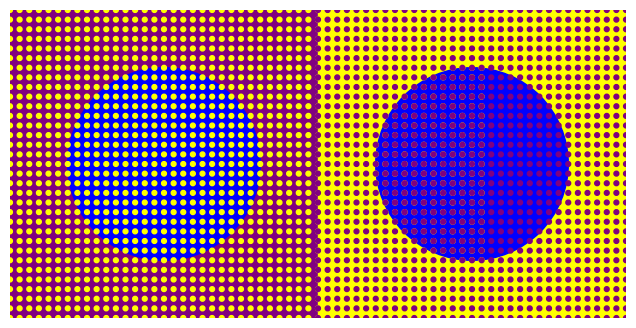

In [ ]:
#@title Munker–White Illusion
# prompt: 左邊畫面裡正方形地規律地排列的黃色圓圈，畫面的中心黃色圓圈們的圖層下放置一個藍色的球，最下面是紫色方形，黃色圓圈在最上面，右邊也一樣，但最下面是黃色方形，最上面紫色圓圈，圓圈們全部都要是正方形排列！覆蓋滿最下面的方形！

import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Circle, Rectangle

# Set up the figure and axes
fig, ax = plt.subplots(figsize=(8, 4))  # Adjust figure size for better layout
ax.set_aspect('equal')
ax.axis('off')  # Hide axes

# Define colors and positions
left_background_color = 'purple'# @param {type:"string", placeholder:"輸入顏色"}
circle_color = 'yellow'#@param {type:"string", placeholder:"輸入顏色"}

right_background_color = 'yellow'#@param {type:"string", placeholder:"輸入顏色"}
circle_color_right = 'purple'#@param {type:"string", placeholder:"輸入顏色"}


# Parameters for the circle arrangement
num_rows = 50
num_cols = num_rows
circle_radius = 0.025
grid_spacing = 0.1


def create_circles(start_x, start_y, num_rows, num_cols, color):
  circles = []
  for i in range(num_rows):
      for j in range(num_cols):
          x = start_x + j * grid_spacing
          y = start_y + i * grid_spacing
          circle = Circle((x, y), circle_radius, color=color)
          circles.append(circle)
          ax.add_patch(circle)
  return circles

# Create the basketballs
basketball_radius = 1


distance=1.6# @param {type:"slider", min:0, max:5, step:0.1}
# Left basketball
left_basketball = Circle((-distance, 0), basketball_radius, color='blue')
ax.add_patch(left_basketball)

# Right basketball
right_basketball = Circle((distance, 0), basketball_radius, color='blue')
ax.add_patch(right_basketball)

# Create background rectangles
left_rect = Rectangle((-distance*2,-distance), distance*2, distance*2, color=left_background_color, zorder=0)
ax.add_patch(left_rect)

right_rect = Rectangle((0,-distance), distance*2, distance*2, color=right_background_color, zorder=0)
ax.add_patch(right_rect)


# Add yellow circles on the left
create_circles(-distance*2,-distance, num_rows, num_cols, circle_color)

# Add purple circles on the right
create_circles(0, -distance, num_rows, num_cols, circle_color_right)




# Set limits
ax.set_xlim(-distance*2, distance*2)
ax.set_ylim(-distance, distance)


plt.show()

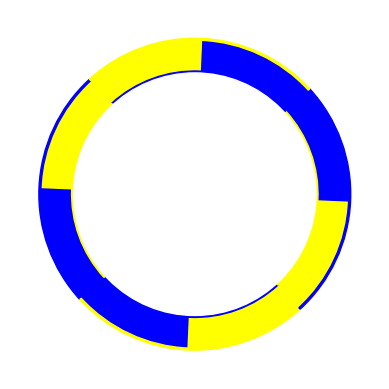

In [ ]:
#@title 日本視覺設計師じゃがりきん的錯覺
#@markdown 通過添加陰影，操弄對比色，讓圖案給人移動或放大的錯覺

#@markdown [出處](https://x.com/jagarikin/status/1331409504953540613)


import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.animation as animation

# 建立圖表和軸
fig, ax = plt.subplots()
plt.axis('off')
# 設定圓環的半徑j
outer_radius = 1
inner_radius = 0.8
border_width = 0.0125

#@markdown 四個扇形 + 內外邊框的顏色
all_wedges = []
colors = ['blue', 'yellow', 'blue', 'yellow', 'blue', 'yellow']# @param {type:"string", placeholder:"enter a value"}

angel=90
half=angel/2
# 主體圓環
for i in range(4):
    wedge = patches.Wedge((0, 0), outer_radius, i * angel, (i + 1) * angel, color=colors[i], width=outer_radius - inner_radius)
    all_wedges.append(wedge)
    ax.add_patch(wedge)

# 內圈邊框 (快半圈)
for i in range(4):
    wedge = patches.Wedge((0, 0), inner_radius, i * angel + half, (i + 1) * angel + half, color=colors[i], width=border_width)
    all_wedges.append(wedge)
    ax.add_patch(wedge)

# 外圈邊框 (慢半圈)
for i in range(4):
    wedge = patches.Wedge((0, 0), outer_radius + border_width, i * angel - half, (i + 1) * angel - half, color=colors[i], width=border_width)
    all_wedges.append(wedge)
    ax.add_patch(wedge)

# 建立中間的空白圓形
circle = patches.Circle((0, 0), inner_radius - border_width, color='white')
ax.add_patch(circle)

# 設定軸的限制
ax.set_xlim(-1.2, 1.2)  # Slightly adjusted for borders
ax.set_ylim(-1.2, 1.2)

# 移除軸標籤和刻度
ax.set_xticks([])
ax.set_yticks([])
ax.set_aspect('equal')
'''
arrowsize=0.25
arrow = patches.Arrow(0, arrowsize/2, 0, arrowsize, width=arrowsize, color='black')
ax.add_patch(arrow)
arrow2 = patches.Arrow(0, -arrowsize/2, 0, -arrowsize, width=arrowsize, color='black')
ax.add_patch(arrow2)
arrow3 = patches.Arrow(arrowsize/2, 0, arrowsize, 0, width=arrowsize, color='black')
ax.add_patch(arrow3)
arrow4 = patches.Arrow(-arrowsize/2, 0, -arrowsize, 0, width=arrowsize, color='black')
ax.add_patch(arrow4)
'''
# 定義動畫更新函數
def animate(i):
    # 旋轉角度，每次增加 5 度
    rotation_angle = i * 2.5

    # 更新每個扇形的角度
    for j, wedge in enumerate(all_wedges):
        # 根據扇形類型調整旋轉速度
        if j < 4:  # 主體圓環
            wedge.set_theta1((j * 90 + rotation_angle) % 360)
            wedge.set_theta2(((j + 1) * 90 + rotation_angle) % 360)
        elif j < 8:  # 內圈邊框 (快半圈)
            wedge.set_theta1((j * 90 + rotation_angle + 45) % 360)
            wedge.set_theta2(((j + 1) * 90 + rotation_angle + 45) % 360)
        else:  # 外圈邊框 (慢半圈)
            wedge.set_theta1((j * 90 + rotation_angle - 45) % 360)
            wedge.set_theta2(((j + 1) * 90 + rotation_angle - 45) % 360)

    return all_wedges

# 建立動畫
ani = animation.FuncAnimation(fig, animate, frames=72, interval=2, blit=True)

mode=0
if mode ==1:
    plt.show()
# 顯示圖表
from IPython.display import HTML
HTML(ani.to_jshtml())

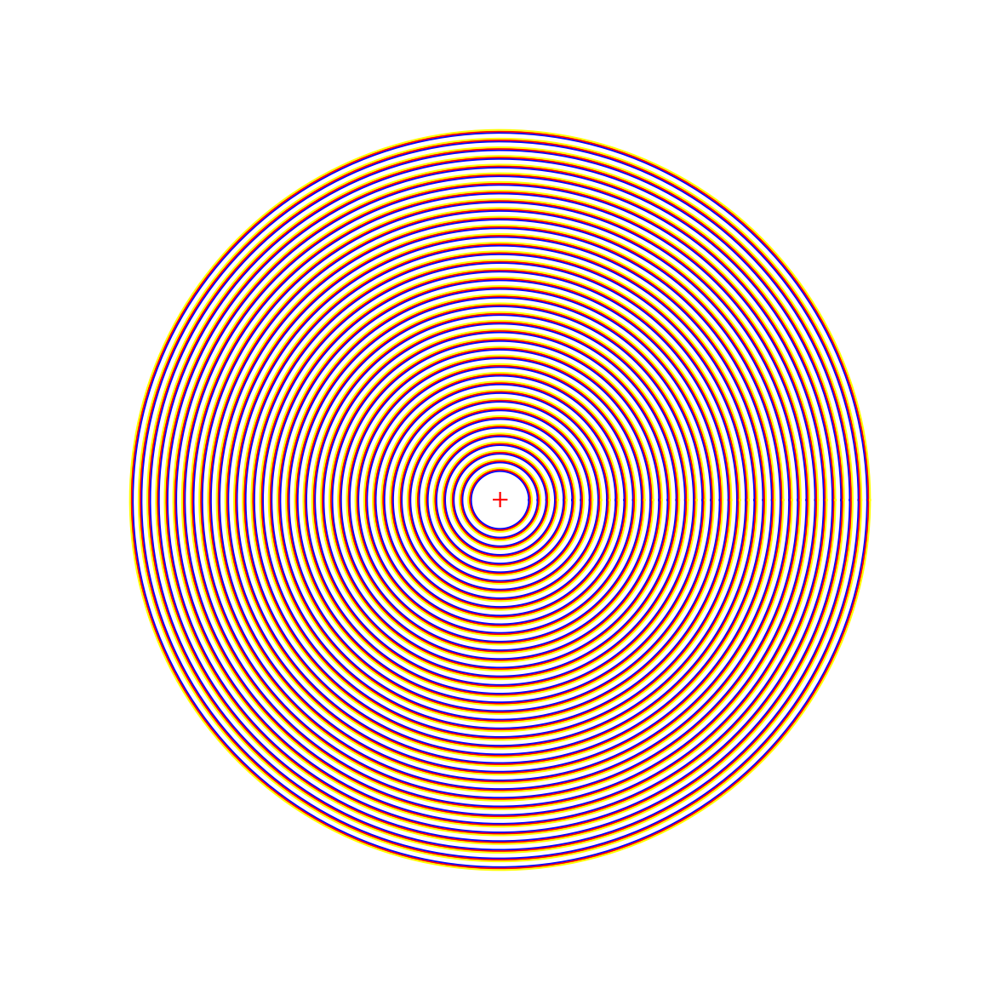

In [ ]:
#@title 盯著中央的紅「+」看久了會眼花的錯覺
# prompt: 一條圓弧，顏色，半徑可以自定義，圓心在(5,5)，圓弧的部分盡可能以一行完成
#@markdown #如果發現圖片在抽搐，請點一下圖片


#@markdown 盯著中央的紅「+」看久了會眼花

#@markdown 為了效果好，所以把圖片弄比較大，因此觸發了google colab的bug，不斷試圖縮放圖片導致圖片抽搐

#@markdown 猜測是運動知覺的細胞受刺激不斷放電所造成
import matplotlib.pyplot as plt
import numpy as np
radius=5
cir_radius=0.3
center_y=0
center_x=0
loop=40
def draw_arc(radius, color, start_angle, end_angle):
    # 產生圓弧上的點
    theta = np.linspace(start_angle, end_angle, 400)  # 生成200个点
    x = radius * np.cos(theta) + center_x
    y = radius * np.sin(theta) + center_y

    # 繪製圓弧
    plt.plot(x, y, color=color)

    # 設定坐標軸範圍，確保圓弧完整顯示
# 計算最大半徑
max_radius = radius + loop * cir_radius
# 設定圖表大小
size=radius+cir_radius*loop-2
plt.figure(figsize=(size, size))
# 設定坐標軸範圍
plt.xlim([- radius - loop*cir_radius , center_x + radius + loop*cir_radius ])
plt.ylim([- radius - loop*cir_radius , center_y + radius + loop*cir_radius ])
plt.gca().set_aspect('equal', adjustable='box')
# 設定圓弧參數
radius = 1  # 半徑
color = "blue"  # 顏色
start_angle = 0  # 起始角度
#end_angle = np.pi / 2 # 結束角度，這裡是 90 度
end_angle = np.pi*2
plt.text(center_x, center_y, '+', fontsize=20, color='red', ha='center', va='center')

q_radius=0.05
for i in range(loop):
    draw_arc(radius+ cir_radius*i, color, start_angle, end_angle)
for i in range(loop):
    draw_arc(radius +q_radius+ cir_radius*i, "red", start_angle, end_angle)
for i in range(loop):
    draw_arc(radius +q_radius*2+cir_radius*i , "yellow", start_angle, end_angle)
plt.axis('off')
plt.show()

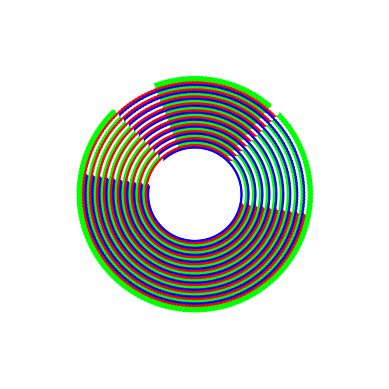

In [ ]:
#@title Colour Assimilation的圓形版本

#@markdown  [普通版本](https://michaelbach.de/ot/col-assim/index.html)

import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np

# 設定圓形參數
num_points = 200
num_layers = 30  # 設定層數
center_x = 0
center_y = 0

# 定義每層的顏色，使用 RGB 格式
original_colors = [[0, 0, 1], [1, 0, 0], [0, 1, 0]]  # 藍色、綠色、紅色
# 定義每層變化後的顏色，使用 RGB 格式
sector_colors = [[1, 1, 1], [1, 1, 1], [1, 1, 1]]  # 黃色、紫色、橙色

# 定義每層變色的角度範圍，使用多個元組表示多個區域
changed_angle_ranges = [
    [(135, 145), (145, 225)],  # 第一層
    [(0, 45), (315, 360)],  # 第二層
    [(45, 100), (100, 135)]   # 第三層
]

# 建立圓形上的點 (for all circles)
theta = np.linspace(0, 2 * np.pi, num_points, endpoint=False)

# 設定扇區參數
#@markdown  變色的扇區大小
sector_angle = 60 # @param {type:"slider", min:0, max:360, step:15}

sector_start1 = 0   # 第一個扇區起始角度
sector_start2 = 180 # 第二個扇區起始角度

# 初始化圖表
fig, ax = plt.subplots()
ax.set_aspect('equal')
ax.set_xlim([-num_layers * 0.1 -1, num_layers * 0.1 +1]) # 調整 x 軸範圍
ax.set_ylim([-num_layers * 0.1 -1, num_layers * 0.1 +1]) # 調整 y 軸範圍

# 建立多層圓圈 (using a loop)
scatters = []
for i in range(num_layers):
    radius = 1+(i + 1) * 0.05  # 半徑隨層數增加
    x = center_x + radius * np.cos(theta)
    y = center_y + radius * np.sin(theta)

    # 使用指定的顏色
    color = original_colors[i % len(original_colors)]  # 循環使用顏色，如果層數超過顏色數量
    scatters.append(ax.scatter(x, y, color=color, s=10))

# 定義動畫更新函式
def update(frame):
    current_angle1 = (frame * 10) % 360  # 第一個扇區每次移動1度
    current_angle2 = (frame * 10 + 120) % 360 # 第二個扇區每次移動1度，起始角度為180度

    # 更新每個圓圈的顏色 (using a loop)
    for scatter, radius, layer_num in zip(scatters, [(i + 1) * 0.1 for i in range(num_layers)], range(num_layers)):
        colors = []
        x = center_x + radius * np.cos(theta)
        y = center_y + radius * np.sin(theta)
        for i in range(num_points):
            point_angle = np.arctan2(y[i], x[i])
            if point_angle < 0:
                point_angle += 2 * np.pi
            point_angle_deg = np.rad2deg(point_angle)

            # 判斷是否在變色的角度範圍內
            in_changed_range = False
            for start_angle, end_angle in changed_angle_ranges[layer_num % len(changed_angle_ranges)]:
                if start_angle <= point_angle_deg < end_angle:
                    in_changed_range = True
                    break

            # 判斷是否在變色的扇區內
            in_sector = (current_angle1 <= point_angle_deg <= current_angle1 + sector_angle) or \
                        (current_angle1 + sector_angle > 360 and point_angle_deg <= (current_angle1 + sector_angle - 360)) or \
                        (current_angle2 <= point_angle_deg <= current_angle2 + sector_angle) or \
                        (current_angle2 + sector_angle > 360 and point_angle_deg <= (current_angle2 + sector_angle - 360))

            # 設定顏色：只有在扇區內且在變色範圍內才變色
            if in_sector and in_changed_range:
                color = sector_colors[layer_num % len(sector_colors)]  # 使用變化顏色
            else:
                color = original_colors[layer_num % len(original_colors)]  # 使用原本顏色

            colors.append(color)

        scatter.set_color(colors)  # Set colors directly

    return scatters # 返回所有圓圈

# 建立動畫
ani = animation.FuncAnimation(fig, update, frames=36, interval=20, blit=True)



plt.axis('off')
'''
plt.figure(figsize=(10, 10))
plt.show()
'''
# 顯示動畫
from IPython.display import HTML
HTML(ani.to_jshtml())

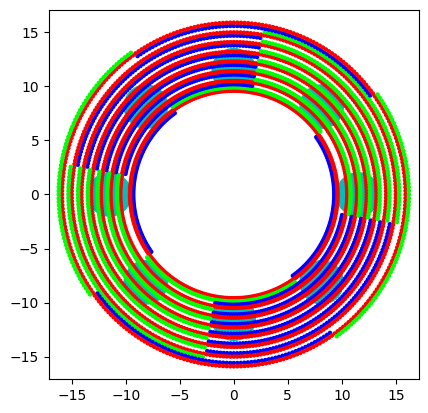

In [1]:
#@title 融合中眾多錯覺的最終作品
from IPython import get_ipython
from IPython.display import display
# %%
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
plt.rcParams['animation.embed_limit'] = 50  # Set limit to 50MB (or any desired value)

# 設定圓形參數
num_points = 300
num_layers = 24
center_x = 0
center_y = 0

# 建立圓形上的點 (for all circles)
theta = np.linspace(0, 2 * np.pi, num_points, endpoint=False)

# 設定扇區參數
sector_angle = 90  # 度
sector_start1 = 0   # 第一個扇區起始角度
sector_start2 = 180 # 第二個扇區起始角度

radius_cir=0.3
radius_offset=9
# 初始化圖表
fig, ax = plt.subplots()
ax.set_aspect('equal')
ax.set_xlim([-num_layers * radius_cir-radius_offset*1.1, num_layers * radius_cir+radius_offset*1.1]) # 調整 x 軸範圍
ax.set_ylim([-num_layers * radius_cir-radius_offset*1.1, num_layers * radius_cir+radius_offset*1.1]) # 調整 y 軸範圍



# 計算圓形的座標，使其在圓環附近平均放置
num_circles = 8  # 設定圓圈數量
circle_radius = 2  # 設定圓形的半徑
circle_spacing = 1  # 設定圓形之間的間距
circle_color = '#00BEBE'  # 設定圓形的顏色
# 計算圓形的角度，使其平均分布在圓環周圍
circle_distance = 11.5
start_angle = np.pi / 4
circle_angles = np.linspace(start_angle, start_angle + 2 * np.pi, num_circles, endpoint=False)

# 計算圓形的座標
circle_positions = []
for angle in circle_angles:
    x = circle_distance * np.cos(angle)
    y = circle_distance * np.sin(angle)
    circle_positions.append((x, y))

# 建立圓形
for x, y in circle_positions:
    circle = plt.Circle((x, y), circle_radius, color=circle_color)
    ax.add_artist(circle)




# 建立多層圓圈 (使用迴圈)
scatters = []
colors = ['#0000ff', '#ff0000', '#ffffff']  # 修改後的顏色列表
sector_colors = ['#ffffff', '#ff0000', '#00ff00']  # 修改後的顏色列表
for i in range(num_layers):
    radius = (i + 1) * radius_cir+radius_offset  # 半徑隨層數增加
    x = center_x + radius * np.cos(theta)
    y = center_y + radius * np.sin(theta)

    # 使用顏色列表循環設定顏色
    color = colors[i % len(colors)]  # 使用顏色列表循環設定顏色
    scatters.append(ax.scatter(x, y, color=color, s=5))

# Store original colors in a separate list
original_colors = [s.get_facecolor()[0] for s in scatters]

color_map = {tuple(c): i for i, c in enumerate(original_colors)}
# 修改颜色映射，将蓝色映射到白色
color_map[tuple(np.array([0, 0, 1, 1]))] = 1  # 蓝色映射到白色



# 定義動畫更新函式
def update(frame):
    base_speed = 10  # 基础速度
    speed_offset = 360 / 8  # 八分之一圈对应的角度偏移

    # 扇區參數
    sector_angle = 90  # 扇區角度
    sector_start1 = 0   # 第一個扇區起始角度
    sector_start2 = 180 # 第二個扇區起始角度

    # 扇區顏色列表
    sector_colors = ['#ffffff', '#ff0000', '#00ff00']  # 白、紅、綠

    for layer_num, scatter, radius, orig_color in zip(range(num_layers), scatters, [(i + 1) * radius_cir + radius_offset for i in range(num_layers)], original_colors):
        point_colors = []

        # 基础角度计算
        current_angle = (frame * base_speed) % 360

        # 根据圈层调整速度感知
        if layer_num < 3:  # 内圈
            current_angle_adjusted = (current_angle + speed_offset) % 360  # 加快八分之一圈
        elif layer_num >= num_layers - 3:  # 外圈
            current_angle_adjusted = (current_angle - speed_offset) % 360  # 减慢八分之一圈
        else:  # 中间圈层
            current_angle_adjusted = current_angle

        # 计算点颜色
        for i in range(num_points):
            point_angle = np.degrees(np.arctan2(np.sin(theta[i]), np.cos(theta[i])))
            if point_angle < 0:
                point_angle += 360

            # 檢查點是否在任一扇區內
            in_sector1 = (sector_start1 <= (point_angle - current_angle_adjusted) % 360 <= sector_start1 + sector_angle)
            in_sector2 = (sector_start2 <= (point_angle - current_angle_adjusted) % 360 <= sector_start2 + sector_angle)
            in_sector = in_sector1 or in_sector2

            # 使用颜色映射获取颜色索引
            color_index = color_map[tuple(orig_color)]

            # 設定顏色：扇區內如果之後是白色，則變透明
            sector_color = sector_colors[color_index % len(sector_colors)]
            if in_sector and color_index == 1:  # 檢查扇區顏色是否為白色
                color = (0, 0, 0, 0)  # 完全透明
            # 扇區外如果原本是白色，也變透明
            elif not in_sector and tuple(orig_color) == tuple(np.array([1, 1, 1, 1])):
                color = (0, 0, 0, 0)  # 完全透明
            # 其他情況維持原色或變為扇區顏色
            else:
                color = sector_color if in_sector else orig_color

            point_colors.append(color)

        scatter.set_color(point_colors)

    return scatters  # 返回所有圓圈



# 建立動畫
ani = animation.FuncAnimation(fig, update, frames=36, interval=20, blit=True)

# 顯示動畫
from IPython.display import HTML
HTML(ani.to_jshtml())


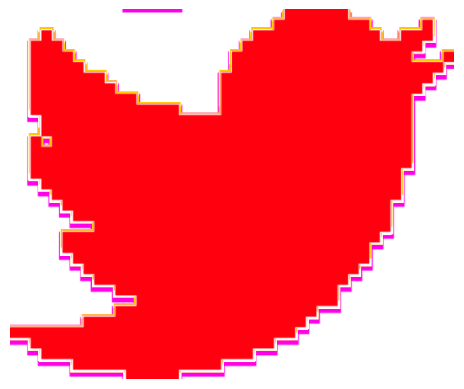

In [ ]:
#@title 試著復現做起，沒有成功

#@markdown  [參考じゃがりきん的錯覺](https://x.com/jagarikin/status/1559790281717071874)

#@markdown  [復現目標](https://x.com/jagarikin/status/1683846312364736513/)

!pip install matplotlib pillow requests  # 安裝必要的函式庫
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.display import HTML
from PIL import Image, ImageFilter
import colorsys
import requests
from io import BytesIO

#https://www.geminiopencloud.com/img/ncku.png
# 載入圖片並進行垂直翻轉
response = requests.get("https://cdn.icon-icons.com/icons2/3195/PNG/512/twitter_tweet_bird_network_icon_194550.png")
image = Image.open(BytesIO(response.content)).convert("RGBA")
image = image.transpose(Image.FLIP_TOP_BOTTOM)  # 垂直翻轉

# 創建擴展區域的函數
def expand_image(image, expansion=10):
    alpha = image.getchannel("A")
    expanded_alpha = alpha.filter(ImageFilter.MaxFilter(expansion * 2 + 1))
    expanded_image = Image.new("RGBA", image.size, (0, 0, 0, 0))
    expanded_image.putalpha(expanded_alpha)
    return expanded_image

# 建立圖表和軸
fig, ax = plt.subplots()
ax.set_xlim(0, image.width)
ax.set_ylim(0, image.height)
ax.axis('off')

# 創建擴展區域
expanded_image_1 = expand_image(image, expansion=2)  # 第一層擴展
expanded_image_2 = expand_image(expanded_image_1, expansion=2)  # 第二層擴展

original_array = np.array(image)
expanded_array_1 = np.array(expanded_image_1)
expanded_array_2 = np.array(expanded_image_2)
im = ax.imshow(expanded_array_2)

# 設置顏色循環
def get_color(hue):
    # 將色相轉換為 RGB 並保持高飽和和高亮度
    rgb = colorsys.hsv_to_rgb(hue, 1, 1)
    return [int(c * 255) for c in rgb]

# 更新函數
def update(frame):
    total_frames = 100
    hue_step = 1 / total_frames

    # 計算不同區域的色相
    hue_base = (frame * hue_step) % 1
    hue_expand_1 = (hue_base + 1 / 7) % 1  # 第一層擴展顏色比圖案快 1/7
    hue_expand_2 = (hue_base - 1 / 7) % 1  # 第二層擴展顏色比圖案快 2/7

    # 獲取顏色
    color_original = get_color(hue_base)
    color_expand_1 = get_color(hue_expand_1)
    color_expand_2 = get_color(hue_expand_2)

    # 調整第二層擴展區域顏色
    new_expanded_array_2 = expanded_array_2.copy()
    for i in range(3):
        new_expanded_array_2[:, :, i] = color_expand_2[i]
    new_expanded_array_2[:, :, 3] = expanded_array_2[:, :, 3]  # 保留透明度

    # 調整第一層擴展區域顏色
    new_expanded_array_1 = expanded_array_1.copy()
    for i in range(3):
        new_expanded_array_1[:, :, i] = color_expand_1[i]
    new_expanded_array_1[:, :, 3] = expanded_array_1[:, :, 3]  # 保留透明度

    # 調整原圖案顏色
    new_original_array = original_array.copy()
    for i in range(3):
        new_original_array[:, :, i] = color_original[i]
    new_original_array[:, :, 3] = original_array[:, :, 3]  # 保留透明度

    # 將影像進行垂直移動，影子上移或下移
    # 假設第一層影子上移，第二層影子下移
    offset_1 = 8  # 調整影子上移
    offset_2 = -4  # 調整影子下移

    # 更新第一層和第二層影像的垂直位置
    shifted_expanded_array_1 = np.roll(new_expanded_array_1, offset_1, axis=0)
    shifted_expanded_array_2 = np.roll(new_expanded_array_2, offset_2, axis=0)

    # 合併圖案和擴展區域
    combined_array = shifted_expanded_array_2.copy()
    mask_1 = expanded_array_1[:, :, 3] > 0
    mask_0 = original_array[:, :, 3] > 0
    combined_array[mask_1] = shifted_expanded_array_1[mask_1]
    combined_array[mask_0] = new_original_array[mask_0]

    # 更新圖片
    im.set_array(combined_array.astype(np.uint8))
    return im,

# 生成動畫
ani = animation.FuncAnimation(fig, update, frames=100, interval=60, blit=True)

# 嵌入動畫
HTML(ani.to_jshtml())


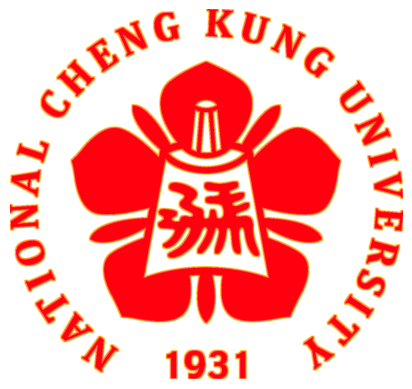

In [ ]:
#@title 很酷，但是沒有成功的錯覺

#@markdown  [參考じゃがりきん的錯覺](https://x.com/jagarikin/status/1559790281717071874)

#@markdown  [參考じゃがりきん的錯覺2](https://x.com/jagarikin/status/1683846312364736513/)

!pip install matplotlib pillow requests  # 安裝必要的函式庫
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.display import HTML
from PIL import Image, ImageFilter
import colorsys
import requests
from io import BytesIO

# 載入圖片並進行垂直翻轉
response = requests.get("https://www.geminiopencloud.com/img/ncku.png")
image = Image.open(BytesIO(response.content)).convert("RGBA")
image = image.transpose(Image.FLIP_TOP_BOTTOM)  # 垂直翻轉

# 創建擴展區域的函數
def expand_image(image, expansion=10):
    alpha = image.getchannel("A")
    expanded_alpha = alpha.filter(ImageFilter.MaxFilter(expansion * 2 + 1))
    expanded_image = Image.new("RGBA", image.size, (0, 0, 0, 0))
    expanded_image.putalpha(expanded_alpha)
    return expanded_image

# 建立圖表和軸
fig, ax = plt.subplots()
ax.set_xlim(0, image.width)
ax.set_ylim(0, image.height)
ax.axis('off')

# 創建擴展區域
expanded_image_1 = expand_image(image, expansion=2)  # 第一層擴展
expanded_image_2 = expand_image(expanded_image_1, expansion=2)  # 第二層擴展

original_array = np.array(image)
expanded_array_1 = np.array(expanded_image_1)
expanded_array_2 = np.array(expanded_image_2)
im = ax.imshow(expanded_array_2)

# 設置顏色循環
def get_color(hue):
    # 將色相轉換為 RGB 並保持高飽和和高亮度
    rgb = colorsys.hsv_to_rgb(hue, 1, 1)
    return [int(c * 255) for c in rgb]

# 更新函數
def update(frame):
    total_frames = 100
    hue_step = 1 / total_frames

    # 計算不同區域的色相
    hue_base = (frame * hue_step) % 1
    hue_expand_1 = (hue_base + 0.5 / 7) % 1  # 第一層擴展顏色比圖案快 1/7
    hue_expand_2 = (hue_base + 1 / 7) % 1  # 第二層擴展顏色比圖案快 2/7

    # 獲取顏色
    color_original = get_color(hue_base)
    color_expand_1 = get_color(hue_expand_1)
    color_expand_2 = get_color(hue_expand_2)

    # 調整第二層擴展區域顏色
    new_expanded_array_2 = expanded_array_2.copy()
    for i in range(3):
        new_expanded_array_2[:, :, i] = color_expand_2[i]
    new_expanded_array_2[:, :, 3] = expanded_array_2[:, :, 3]  # 保留透明度

    # 調整第一層擴展區域顏色
    new_expanded_array_1 = expanded_array_1.copy()
    for i in range(3):
        new_expanded_array_1[:, :, i] = color_expand_1[i]
    new_expanded_array_1[:, :, 3] = expanded_array_1[:, :, 3]  # 保留透明度

    # 調整原圖案顏色
    new_original_array = original_array.copy()
    for i in range(3):
        new_original_array[:, :, i] = color_original[i]
    new_original_array[:, :, 3] = original_array[:, :, 3]  # 保留透明度

    # 合併圖案和擴展區域
    combined_array = new_expanded_array_2.copy()
    mask_1 = expanded_array_1[:, :, 3] > 0
    mask_0 = original_array[:, :, 3] > 0
    combined_array[mask_1] = new_expanded_array_1[mask_1]
    combined_array[mask_0] = new_original_array[mask_0]

    # 更新圖片
    im.set_array(combined_array.astype(np.uint8))
    return im,

# 生成動畫
ani = animation.FuncAnimation(fig, update, frames=100, interval=50, blit=True)

# 嵌入動畫
HTML(ani.to_jshtml())
